# Processing, analysis, and visualization pipeline for detecting and quantifying spontaneous peaks in fiber-photometry data with 4 concurrent measures

In [ ]:
%pylab inline
%load_ext autoreload
%autoreload 2
import pynit as pn #reads BIDS database format into pipeline
import pandas as pd
import matplotlib.patches as patches
import matplotlib.ticker as ticker
import numpy as np
import scipy.fftpack
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from pandas import DataFrame, date_range, datetime, read_csv
from matplotlib import pyplot, colors, rcParams 
from datetime import timedelta  
from scipy.signal import find_peaks, find_peaks_cwt, butter, lfilter, freqz, sosfilt, welch, filtfilt, lfilter_zi, sosfilt_zi, sosfiltfilt
from numpy import NaN, asarray
from math import isnan
import seaborn as sns

rcParams['figure.dpi'] = 300
rcParams['font.family'] = 'sans-serif'
rcParams['font.sans-serif'] = ['Liberation Sans']

import warnings
warnings.filterwarnings("ignore")

# Plot formatting helper function

In [3]:
def tsplot(df, add_plot=None, figsize=None, xlim=None, ylim=None, xlabel=None, ylabel=None,
               label_size=None, tick_size=None, title=None, title_size=None, err=0, **kwargs):
        """

        :param df:
        :param figsize:
        :param xlim:
        :param ylim:
        :param xlabel:
        :param ylabel:
        :param label_size:
        :param tick_size:
        :param title:
        :param title_size:
        :param err: 0 = standard deviation, 1 = standard error
        :param kwargs:
        :return:
        """
        if not add_plot:
            fig, axes = plt.subplots(1,1,figsize=figsize)
        else:
            fig, axes = add_plot
        fig.patch.set_facecolor('white')
        axes.spines['top'].set_visible(False)
        axes.spines['right'].set_visible(False)
        for axis in ['top','bottom','left','right']:
              axes.spines[axis].set_linewidth(5)
        if xlim:
            axes.set_xlim(xlim)
        if ylim:
            axes.set_ylim(ylim)
        if title:
            axes.set_title(title, size=title_size)
        if xlabel:
            axes.set_xlabel(xlabel, size=label_size)
        else:
            axes.set_xlabel('Time (s)', size=label_size)
        if ylabel:
            axes.set_ylabel(ylabel, size=label_size)
        else:
            axes.set_ylabel('Responses', size=label_size)
        tlen = int(tick_size/5)
        
        axes.tick_params(labelsize=tick_size, direction='out', top='off', right='off', width = 5, length = tlen)
        grey2 = [colors.to_rgba('grey',.1)]
        
        if err == 1:
            sns.tsplot(df.T.values, err_style='sterr_band', ax=axes,  **kwargs)
            
        elif err == 0:
            sns.tsplot(df.T.values, err_style=None, ax=axes, **kwargs)
        else:
            sns.tsplot(df.T.values, err_style='unit_traces', err_palette = grey2, err_kws = {'alpha':.15}, ax=axes, **kwargs)
        return fig, axes

# load BIDS format project object from parent directory
## This should point to project in a \project\subproject\group\dtype\ directory organization

In [ ]:
prj = pn.Project('/home/user/project') 
prj.reload() # reload all updates
prj(2, ext=['.xlsx']).summary

# function to get group-level data from project object

In [4]:
def get_data_from_group(prj, group, region):
    new_prj = prj(2, 'my-main-project-folder-name', 'my-subproject-folder-name-if-applicable', group, ext='.xlsx') #enter your own values here
    df = pd.DataFrame()
    for i, finfo in new_prj:
        df[i] = pd.read_excel(finfo.Abspath)[region]
    return df

# function to define butterworth highpass filter to remove baseline/low frequency fluctuations

In [5]:
def butter_highpass(fs, order):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq

    sos = butter(order, normal_cutoff, btype='high', analog=False, output = 'sos')

    return  sos

# function to define how butterworth filter is to be applied

In [6]:
def butter_highpass_filter(data, fs, order):
    sos = butter_highpass(fs, order=order)
    zi= sosfilt_zi(sos)
    y,zf = sosfilt(sos, data, zi=zi*data[0])
#     y = sosfiltfilt(sos, data, padtype= None) #use this instead of above if you want to apply bidirectional filtering
    return y

## function to apply butterworth filter to all timeseries

In [7]:
def filter_data(raw):
    filtered = pd.DataFrame()
    for name in raw.columns:
        data = raw[name].dropna().values
        # Filter requirements.
        order = 3 #adjust this a needed
        fs = freq      # sample rate, Hz
        
        # Get the filter coefficients so we can check its frequency response.
        sos = butter_highpass(fs, order)

        y = butter_highpass_filter(data, fs, order)

        y = pd.DataFrame(y)
        filtered[name]=y[0] 
    return filtered

# function to correct baseline drift by subtracting OLS line of best fit

In [8]:
def flatten_data(y):
    
    y2 = y 
    
    for name in y.columns:
        
        Y = y[name].values

        Y = Y[~numpy.isnan(Y)].reshape(-1,1)
        
        X = np.array(range(len(Y))).reshape(-1,1)
        
        lr = LinearRegression().fit(X, Y)  # perform linear regression

        slope = lr.coef_[0][0]
        y_int = lr.intercept_[0]          
        
        for i in range(len(Y)):
            y2[name][i] = Y[i] - (slope * i + y_int)
                
    return y2

# function to baseline correct, z normalize, butterworth filter, find peaks over a certain percentile in each trial for first measure and plot peak locations for all measures, bin all trials from all measures into epochs surrounding the corresponding peaks, export data to excel, plot group data mean +/- SEM and individual trial epochs relative to peak timing, find largest group peak after first-measure peak and print its location, plot and export peak heights for other measures for each trial

## Change veriables to fit your paradigm as needed here or when calling function

In [13]:
def plot_example_data4(prj, photo_group, first_measure = 'G', second_measure = 'HbT', third_measure = 'HbO', fourth_measure = 'HbR',epochstart = -150, epochend = 300, blength = 100, percentile = 97.7,
                       distance = 300, figsize=[7.5,7.5], figsizea=[7.5,7.5], figsizeb=[12.5,7.5], label_size=60, err=2,
                       title_size=60, tick_size=50, first_ylabel='GCaMP (Z)', second_ylabel = 'CBV (Z)', third_ylabel = 'HbO (Z)', fourth_ylabel = 'HbR (Z)', xlabel='Time (s)', n_tick_b=150, n_tick_d=1200, 
                       avg_start = -2, avg_end = 2, linewidth = 5):
            
    
    data_gcamp = get_data_from_group(prj, photo_group, first_measure)
    data_td = get_data_from_group(prj, photo_group, second_measure)
    data_O = get_data_from_group(prj, photo_group, third_measure)
    data_R = get_data_from_group(prj, photo_group, fourth_measure)
    
    data_gcampE = flatten_data(data_gcamp)
    data_tdE = flatten_data(data_td)
    data_OE = flatten_data(data_O)
    data_RE = flatten_data(data_R)
    
    for col in data_gcampE.columns:
        data_gcampE[col]= ((data_gcampE[col] - np.mean(data_gcampE[col]))/np.std(data_gcampE)[col])
    for col in data_tdE.columns:
        data_tdE[col]= ((data_tdE[col] - np.mean(data_tdE[col]))/np.std(data_tdE[col]))
    for col in data_OE.columns:
        data_OE[col]= ((data_OE[col] - np.mean(data_OE[col]))/np.std(data_OE[col]))
    for col in data_RE.columns:
        data_RE[col]= ((data_RE[col] - np.mean(data_RE[col]))/np.std(data_RE[col]))
    
    data_ratio = filter_data(data_gcamp)
    
    peakdf = DataFrame();
    
    for name in data_ratio.columns:
        dfup = data_ratio[name].dropna().tolist();
        pp = np.nanpercentile(dfup, percentile)
        
        #find peaks over a certain percentile value
        peaks, _ = find_peaks(dfup, height = pp, distance = distance) #25 = 1 s between peaks

        peaks = pd.DataFrame(peaks.tolist(), index=None, columns=None)
        peakdf[name] = peaks[0][((peaks[0]>=abs(epochstart))&(peaks[0]<=(len(dfup)-epochend))).dropna()]
    
    print 'Data from:'+ data_gcamp.shape[1] + 'trials'
    print 'total peaks detected' + sum(peakdf.count())
    
    peakdf.to_excel('{}_{}_Peaks.xlsx'.format(photo_group, first_measure), index = None, header = None)
    data_ratio.to_excel('{}_{}_Filtered.xlsx'.format(photo_group, first_measure), index = None, header = None)
    data_td.to_excel('{}_{}.xlsx'.format(photo_group,second_measure), index = None, header = None)
    data_gcamp.to_excel('{}_{}.xlsx'.format(photo_group,first_measure), index = None, header = None)
    data_O.to_excel('{}_{}.xlsx'.format(photo_group,third_measure), index = None, header = None)
    data_R.to_excel('{}_{}.xlsx'.format(photo_group,fourth_measure), index = None, header = None)
    
    
    Tdepochsdf = DataFrame();
    
    for nam in peakdf.columns:
        Tdepochdf = DataFrame();
        peaklist = peakdf[nam].dropna().astype(int).tolist();
        for idx, i in enumerate(peaklist):
            if i+epochstart >= 0:
                if i+epochend <= len(data_td[nam].dropna()):
                    Tdepoch = data_td.iloc[i+epochstart:i+epochend,nam].tolist()
                    if len(Tdepoch) >= epochend - epochstart:
                        Tdepochdf[idx]= Tdepoch
        Tdepochsdf=pd.concat([Tdepochsdf,Tdepochdf], axis = 1, ignore_index=True)
        
        Tdepochdf.to_excel('{}_{}_{}_Epoch.xlsx'.format(photo_group, nam, second_measure), index = None, header = None)
    
    Tdepochsdf = flatten_data(Tdepochsdf)
    for col in Tdepochsdf.columns:
        Tdepochsdf[col]= ((Tdepochsdf[col] - np.mean(Tdepochsdf[col].iloc[0:blength]))/np.std(Tdepochsdf[col].iloc[0:blength]))
    
    Tdepochsdf.to_excel('{}_{}_Epochs.xlsx'.format(photo_group, second_measure), index = None, header = None)
    
    Tdmean = Tdepochsdf.mean(axis=1).abs()
    
    Gepochsdf = DataFrame();
    
    for nam in peakdf.columns:
        Gepochdf = DataFrame();
        peaklist = peakdf[nam].dropna().astype(int).tolist();
        for idx, i in enumerate(peaklist):
            if i+epochstart >= 0:
                if i+epochend <= len(data_gcamp[nam].dropna()):
                    Gepoch = data_gcamp.iloc[i+epochstart:i+epochend,nam].tolist()
                    if len(Gepoch) >= epochend - epochstart:
                        Gepochdf[idx]= Gepoch
        Gepochsdf=pd.concat([Gepochsdf,Gepochdf], axis = 1, ignore_index=True)
        
        Gepochdf.to_excel('{}_{}_{}_Epoch.xlsx'.format(photo_group, nam, first_measure), index = None, header = None)
    
    Gepochsdf = flatten_data(Gepochsdf)
    for col in Gepochsdf.columns:
        Gepochsdf[col]= ((Gepochsdf[col] - np.mean(Gepochsdf[col].iloc[0:blength]))/np.std(Gepochsdf[col].iloc[0:blength]))
    
    Gepochsdf.to_excel('{}_{}_Epochs.xlsx'.format(photo_group, first_measure), index = None, header = None)
    
    Gmean = Gepochsdf.mean(axis=1).abs()
    
    Oepochsdf = DataFrame();
    
    for nam in peakdf.columns:
        Oepochdf = DataFrame();
        peaklist = peakdf[nam].dropna().astype(int).tolist();
        for idx, i in enumerate(peaklist):
            if i+epochstart >= 0:
                if i+epochend <= len(data_O[nam].dropna()):
                    Oepoch = data_O.iloc[i+epochstart:i+epochend,nam].tolist()
                    if len(Oepoch) >= epochend - epochstart:
                        Oepochdf[idx]= Oepoch
        Oepochsdf=pd.concat([Oepochsdf,Oepochdf], axis = 1, ignore_index=True)
        
        Oepochdf.to_excel('{}_{}_{}_Epoch.xlsx'.format(photo_group, nam, third_measure), index = None, header = None)
    
    Oepochsdf = flatten_data(Oepochsdf)
    for col in Oepochsdf.columns:
        Oepochsdf[col]= ((Oepochsdf[col] - np.mean(Oepochsdf[col].iloc[0:blength]))/np.std(Oepochsdf[col].iloc[0:blength]))
    
    Oepochsdf.to_excel('{}_{}_Epochs.xlsx'.format(photo_group, thids_measure), index = None, header = None)
    
    Omean = Oepochsdf.mean(axis=1).abs()
        
    Repochsdf = DataFrame();
    
    for nam in peakdf.columns:
        Repochdf = DataFrame();
        peaklist = peakdf[nam].dropna().astype(int).tolist();
        for idx, i in enumerate(peaklist):
            if i+epochstart >= 0:
                if i+epochend <= len(data_R[nam].dropna()):
                    Repoch = data_R.iloc[i+epochstart:i+epochend,nam].tolist()
                    if len(Repoch) >= epochend - epochstart:
                        Repochdf[idx]= Repoch
        Repochsdf=pd.concat([Repochsdf,Repochdf], axis = 1, ignore_index=True)
        
        Repochdf.to_excel('{}_{}_{}_Epoch.xlsx'.format(photo_group, nam, fourth_measure), index = None, header = None)
    
    Repochsdf = flatten_data(Repochsdf)
    for col in Repochsdf.columns:
        Repochsdf[col]= ((Repochsdf[col] - np.mean(Repochsdf[col].iloc[0:blength]))/np.std(Repochsdf[col].iloc[0:blength]))
    
    Repochsdf.to_excel('{}_{}_Epochs.xlsx'.format(photo_group, fourth_measure), index = None, header = None)
    
    Rmean = Repochsdf.mean(axis=1).abs()
    
    exampledfG = DataFrame()
    
    for ex in data_gcampE.columns:
        newcol = []
        trialend = pd.Series(data_gcampE[ex]).count()
        newcol = newcol + [NaN]*(trialend);
        expeaks = peakdf[ex].dropna().astype(int).tolist();
        exvalues = data_gcampE[ex].dropna().tolist();
        for (peakx) in expeaks:
            newcol[peakx] = exvalues[peakx]
        newcol= pd.DataFrame(newcol)
        exampledfG[ex] = newcol[0]
        
    exampledfTd = DataFrame()
    
    for ex in data_tdE.columns:
        newcol = []
        trialend = pd.Series(data_tdE[ex]).count()
        newcol = newcol + [NaN]*(trialend);
        expeaks = peakdf[ex].dropna().astype(int).tolist();
        exvalues = data_tdE[ex].dropna().tolist();
        for (peakx) in expeaks:
            newcol[peakx] = exvalues[peakx]
        newcol= pd.DataFrame(newcol)
        exampledfTd[ex] = newcol[0]
    
    exampledfO = DataFrame()
    
    for ex in data_OE.columns:
        newcol = []
        trialend = pd.Series(data_OE[ex]).count()
        newcol = newcol + [NaN]*(trialend);
        expeaks = peakdf[ex].dropna().astype(int).tolist();
        exvalues = data_OE[ex].dropna().tolist();
        for (peakx) in expeaks:
            newcol[peakx] = exvalues[peakx]
        newcol= pd.DataFrame(newcol)
        exampledfO[ex] = newcol[0]
  
    exampledfR = DataFrame()
    
    for ex in data_RE.columns:
        newcol = []
        trialend = pd.Series(data_RE[ex]).count()
        newcol = newcol + [NaN]*(trialend);
        expeaks = peakdf[ex].dropna().astype(int).tolist();
        exvalues = data_RE[ex].dropna().tolist();
        for (peakx) in expeaks:
            newcol[peakx] = exvalues[peakx]
        newcol= pd.DataFrame(newcol)
        exampledfR[ex] = newcol[0]
        
    Gmean = pd.DataFrame(Gmean)
    Gmean = Gmean[0].tolist();
    
    Gloc = Gmean.index(max(Gmean))
    print first_measure + " reference peak location within each epoch is at " + Gloc
    
    ax = tsplot(Gepochsdf, color = 'tab:green', err=err, figsize=figsize,label_size=label_size, linewidth = linewidth,
                         title_size=title_size, tick_size=tick_size, ylabel=first_ylabel, xlabel=xlabel)
    
    ax[1].set_xlim(right = epochend-epochstart)
    ax[1].xaxis.set_major_locator(ticker.MultipleLocator(n_tick_b))
    ax[1].xaxis.set_major_formatter(FuncFormatter(numfmt))
    ylim_neg = ax[1].get_ylim()
    
    ay = tsplot(Gepochsdf, color = 'tab:green', err=1, figsize=figsizea,label_size=label_size, linewidth = linewidth,
                         title_size=title_size, tick_size=tick_size, ylabel=first_ylabel, xlabel=xlabel)
    
    ay[1].set_xlim(right = epochend-epochstart)
    ay[1].xaxis.set_major_locator(ticker.MultipleLocator(n_tick_b))
    ay[1].xaxis.set_major_formatter(FuncFormatter(numfmt))
    ylim_neg = ay[1].get_ylim()
               
    Tdmean = pd.DataFrame(Tdmean)
    Tdmean = Tdmean[0].tolist();
    
    Tloc = Tdmean.index(max(Tdmean))
    print second_measure + " peak location is at " + Tloc
    
    ax1 = tsplot(Tdepochsdf, color = 'tab:red', err=err, figsize=figsize,label_size=label_size, linewidth = linewidth,
                          title_size=title_size, tick_size=tick_size, ylabel=second_ylabel, xlabel=xlabel)
        
    ax1[1].set_xlim(right = epochend-epochstart)
    ax1[1].xaxis.set_major_locator(ticker.MultipleLocator(n_tick_b))
    ax1[1].xaxis.set_major_formatter(FuncFormatter(numfmt))
    ylim_neg = ax1[1].get_ylim()
        
    ay1 = tsplot(Tdepochsdf, color = 'tab:red', err=1, figsize=figsizea,label_size=label_size, linewidth = linewidth,
                          title_size=title_size, tick_size=tick_size, ylabel=second_ylabel, xlabel=xlabel)
        
    ay1[1].set_xlim(right = epochend-epochstart)
    ay1[1].xaxis.set_major_locator(ticker.MultipleLocator(n_tick_b))
    ay1[1].xaxis.set_major_formatter(FuncFormatter(numfmt))
    ylim_neg = ay1[1].get_ylim()

    Omean = pd.DataFrame(Omean)
    Omean = Omean[0].tolist();
    
    Oloc = Omean.index(max(Omean))
    third_measure + " peak location is at " + Oloc
        
    ax2 = tsplot(Oepochsdf, color = 'tab:blue', err=err, figsize=figsize,label_size=label_size, linewidth = linewidth,
                          title_size=title_size, tick_size=tick_size, ylabel=third_ylabel, xlabel=xlabel)
    
    ax2[1].set_xlim(right = epochend-epochstart)
    ax2[1].xaxis.set_major_locator(ticker.MultipleLocator(n_tick_b))
    ax2[1].xaxis.set_major_formatter(FuncFormatter(numfmt))
    ylim_neg = ax2[1].get_ylim()
    
    
    ay2 = tsplot(Oepochsdf, color = 'tab:blue', err=1, figsize=figsizea,label_size=label_size, linewidth = linewidth,
                          title_size=title_size, tick_size=tick_size, ylabel=third_ylabel, xlabel=xlabel)
    
    ay2[1].set_xlim(right = epochend-epochstart)
    ay2[1].xaxis.set_major_locator(ticker.MultipleLocator(n_tick_b))
    ay2[1].xaxis.set_major_formatter(FuncFormatter(numfmt))
    ylim_neg = ay2[1].get_ylim()
    
    
    Rmean = pd.DataFrame(Rmean)
    Rmean = Rmean[0].tolist();
    
    Rloc = Rmean.index(max(Rmean))
    fourth_measure + " peak location is at " + Rloc
    
    ax3 = tsplot(Repochsdf, color = 'black', err=err, figsize=figsize,label_size=label_size, linewidth = linewidth,
                          title_size=title_size, tick_size=tick_size, ylabel=fourth_ylabel, xlabel=xlabel)
    
    ax3[1].set_xlim(right = epochend-epochstart)
    ax3[1].xaxis.set_major_locator(ticker.MultipleLocator(n_tick_b))
    ax3[1].xaxis.set_major_formatter(FuncFormatter(numfmt))
    ylim_neg = ax3[1].get_ylim()
   

    ay3 = tsplot(Repochsdf, color = 'black', err=1, figsize=figsizea,label_size=label_size,linewidth = linewidth,
                          title_size=title_size, tick_size=tick_size, ylabel=fourth_ylabel, xlabel=xlabel)
    
    ay3[1].set_xlim(right = epochend-epochstart)
    ay3[1].xaxis.set_major_locator(ticker.MultipleLocator(n_tick_b))
    ay3[1].xaxis.set_major_formatter(FuncFormatter(numfmt))
    ylim_neg = ay3[1].get_ylim()
   
    
    for ex in exampledfG.columns:
    
        ae = tsplot(data_gcampE[ex], color = 'tab:green', err=err, figsize=figsizeb,label_size=label_size,
                             title_size=title_size, tick_size=tick_size, ylabel=first_ylabel, xlabel=xlabel, linewidth = linewidth)
        ae = tsplot(exampledfG[ex], marker= 7, markersize=tick_size, tick_size=tick_size, color='black', legend=False, figsize=figsizeb, linewidth = linewidth,
                             add_plot = ae)
        ae = tsplot(data_gcampE[ex]*np.nan, color = 'black', err=err, figsize=figsizeb,label_size=label_size,linewidth = linewidth,
                             title_size=title_size, tick_size=tick_size, ylabel=first_ylabel, xlabel=xlabel, add_plot=ae)
             
        ae[1].set_xlim(right = pd.Series(data_gcampE[ex]).count())
        ae[1].xaxis.set_major_locator(ticker.MultipleLocator(n_tick_d))
        ae[1].xaxis.set_major_formatter(FuncFormatter(numfmtE))
        ylim_neg = ae[1].get_ylim()
        
        for i, p in enumerate(peakdf[ex].dropna().astype(int).tolist()):

            if (i % 2) == 0:
                ae[1].add_patch(patches.Rectangle((p + epochstart, ((abs(ylim_neg[0])+abs(ylim_neg[1]))*.98)+ylim_neg[0]),
                                                  epochend - epochstart, (abs(ylim_neg[0])+abs(ylim_neg[1]))*.02, 
                                                  color= colors.to_rgba('purple',.3)))
            else:
                ae[1].add_patch(patches.Rectangle((p + epochstart, ((abs(ylim_neg[0])+abs(ylim_neg[1]))*.955)+ylim_neg[0]),
                                                  epochend - epochstart, (abs(ylim_neg[0])+abs(ylim_neg[1]))*.02, 
                                                  color= colors.to_rgba('purple',.3)))
        
    for ex in exampledfTd.columns:
    
        ae1 = tsplot(data_tdE[ex], color = 'tab:red', err=err, figsize=figsizeb,label_size=label_size,linewidth = linewidth,
                              title_size=title_size, tick_size=tick_size, ylabel=second_ylabel, xlabel=xlabel)
           
        ae1[1].set_xlim(right = pd.Series(data_tdE[ex]).count())
        ae1[1].xaxis.set_major_locator(ticker.MultipleLocator(n_tick_d))
        ae1[1].xaxis.set_major_formatter(FuncFormatter(numfmtE))
        ylim_neg = ae1[1].get_ylim()
        
        for i, p in enumerate(peakdf[ex].dropna().astype(int).tolist()):
              
            if (i % 2) == 0:
                ae1[1].add_patch(patches.Rectangle((p + epochstart, ((abs(ylim_neg[0])+abs(ylim_neg[1]))*.98)+ylim_neg[0]),
                                                  epochend - epochstart, (abs(ylim_neg[0])+abs(ylim_neg[1]))*.02, 
                                                  color= colors.to_rgba('purple',.3)))
            else:
                ae1[1].add_patch(patches.Rectangle((p + epochstart, ((abs(ylim_neg[0])+abs(ylim_neg[1]))*.955)+ylim_neg[0]),
                                                  epochend - epochstart, (abs(ylim_neg[0])+abs(ylim_neg[1]))*.02, 
                                                  color= colors.to_rgba('purple',.3)))

    for ex in exampledfO.columns:
    
        ae2 = tsplot(data_OE[ex], color = 'tab:blue', err=err, figsize=figsizeb,label_size=label_size,linewidth = linewidth,
                              title_size=title_size, tick_size=tick_size, ylabel=third_ylabel, xlabel=xlabel)
           
        ae2[1].set_xlim(right = pd.Series(data_OE[ex]).count())
        ae2[1].xaxis.set_major_locator(ticker.MultipleLocator(n_tick_d))
        ae2[1].xaxis.set_major_formatter(FuncFormatter(numfmtE))
        ylim_neg = ae2[1].get_ylim()
        
        for i, p in enumerate(peakdf[ex].dropna().astype(int).tolist()):
            
            if (i % 2) == 0:
                ae2[1].add_patch(patches.Rectangle((p + epochstart, ((abs(ylim_neg[0])+abs(ylim_neg[1]))*.98)+ylim_neg[0]),
                                                  epochend - epochstart, (abs(ylim_neg[0])+abs(ylim_neg[1]))*.02, 
                                                  color= colors.to_rgba('purple',.3)))
            else:
                ae2[1].add_patch(patches.Rectangle((p + epochstart, ((abs(ylim_neg[0])+abs(ylim_neg[1]))*.955)+ylim_neg[0]),
                                                  epochend - epochstart, (abs(ylim_neg[0])+abs(ylim_neg[1]))*.02, 
                                                  color= colors.to_rgba('purple',.3)))
                
    for ex in exampledfR.columns:
    
        ae3 = tsplot(data_RE[ex], color = 'black', err=err, figsize=figsizeb,label_size=label_size,linewidth = linewidth,
                              title_size=title_size, tick_size=tick_size, ylabel=fourth_ylabel, xlabel=xlabel)
        
        ae3[1].set_xlim(right = pd.Series(data_RE[ex]).count())
        ae3[1].xaxis.set_major_locator(ticker.MultipleLocator(n_tick_d))
        ae3[1].xaxis.set_major_formatter(FuncFormatter(numfmtE))
        ylim_neg = ae3[1].get_ylim()
        
        for i, p in enumerate(peakdf[ex].dropna().astype(int).tolist()):
            
            if (i % 2) == 0:
                ae3[1].add_patch(patches.Rectangle((p + epochstart, ((abs(ylim_neg[0])+abs(ylim_neg[1]))*.98)+ylim_neg[0]),
                                                  epochend - epochstart, (abs(ylim_neg[0])+abs(ylim_neg[1]))*.02, 
                                                  color= colors.to_rgba('purple',.3)))
            else:
                ae3[1].add_patch(patches.Rectangle((p + epochstart, ((abs(ylim_neg[0])+abs(ylim_neg[1]))*.955)+ylim_neg[0]),
                                                  epochend - epochstart, (abs(ylim_neg[0])+abs(ylim_neg[1]))*.02, 
                                                  color= colors.to_rgba('purple',.3)))
            

    ap = Gepochsdf.plot(cmap='summer',legend=False, figsize= figsize, linewidth=linewidth/4)
    ap.set_prop_cycle(pyplot.rcParams["axes.prop_cycle"])
    Gdf = DataFrame()
    
    Gcsvdf = DataFrame(data=None, columns=['Name','PeakX', 'PeakY'])
    
    styles = {}
    count=0
    for name in Gepochsdf.columns:
        list = Gepochsdf[name].tolist();
               
        peakx=Gloc
        peaky=sum(list[Gloc+avg_start:Gloc+avg_end]) / len(list[Gloc+avg_start:Gloc+avg_end])
        
        newcol = []
        newcol = newcol + [NaN]*(Gepochsdf.count()[0]);
        
        newcol[peakx] = peaky

        Gdf[int(name)] = newcol
        Gcsvdf = Gcsvdf.append({'Name':name, 'PeakX': peakx, 'PeakY':peaky}, ignore_index=True);

    Gcsvdf.to_csv('{}_{}_{}.csv'.format(photo_group, first_measure, 'Peaks'))
    a = Gdf.plot(marker= 7, color='black', legend=False, ax = ap)
    ap.add_patch(patches.Rectangle((Gloc+avg_start-0.5,-100),avg_end-avg_start+1, 200, color='b', alpha=.09))
    pyplot.show()
            
    ap1 = Tdepochsdf.plot(cmap='summer',legend=False, figsize= figsize, linewidth=linewidth/4)
    ap1.set_prop_cycle(pyplot.rcParams["axes.prop_cycle"])
    Tdf = DataFrame()
    
    Tcsvdf = DataFrame(data=None, columns=['Name','PeakX', 'PeakY'])
    
    styles = {}
    count=0
    for name in Tdepochsdf.columns:
        list = Tdepochsdf[name].tolist();
               
        peakx=Tloc
        peaky=sum(list[Tloc+avg_start:Tloc+avg_end]) / len(list[Tloc+avg_start:Tloc+avg_end])
        
        newcol = []
        newcol = newcol + [NaN]*(Tdepochsdf.count()[0]);
        
        newcol[peakx] = peaky

        Tdf[int(name)] = newcol
        Tcsvdf = Tcsvdf.append({'Name':name, 'PeakX': peakx, 'PeakY':peaky}, ignore_index=True);

    Tcsvdf.to_csv('{}_{}_{}.csv'.format(photo_group, second_measure, 'Peaks'))
    a1 = Tdf.plot(marker= 7, color='black', legend=False, ax = ap1)
    ap1.add_patch(patches.Rectangle((Tloc+avg_start-0.5,-100),avg_end-avg_start+1, 200, color='b', alpha=.09))
    pyplot.show()
         
    ap2 = Oepochsdf.plot(cmap='summer',legend=False, figsize= figsize, linewidth=linewidth/4)
    ap2.set_prop_cycle(pyplot.rcParams["axes.prop_cycle"])
    Odf = DataFrame()
    
    Ocsvdf = DataFrame(data=None, columns=['Name','PeakX', 'PeakY'])
    
    styles = {}
    count=0
    for name in Oepochsdf.columns:
        list = Oepochsdf[name].tolist();
               
        peakx=Oloc
        peaky=sum(list[Oloc+avg_start:Oloc+avg_end]) / len(list[Oloc+avg_start:Oloc+avg_end])
        
        newcol = []
        newcol = newcol + [NaN]*(Oepochsdf.count()[0]);
        
        newcol[peakx] = peaky

        Odf[int(name)] = newcol
        Ocsvdf = Ocsvdf.append({'Name':name, 'PeakX': peakx, 'PeakY':peaky}, ignore_index=True);

    Ocsvdf.to_csv('{}_{}_{}.csv'.format(photo_group, third_measure, 'Peaks'))
    a2 = Odf.plot(marker= 7, color='black', legend=False, ax = ap2)
    ap2.add_patch(patches.Rectangle((Oloc+avg_start-0.5,-100),avg_end-avg_start+1, 200, color='b', alpha=.09))
    pyplot.show()
           
    ap3 = Repochsdf.plot(cmap='summer',legend=False, figsize= figsize, linewidth=linewidth/4)
    ap3.set_prop_cycle(pyplot.rcParams["axes.prop_cycle"])
    Rdf = DataFrame()
    
    Rcsvdf = DataFrame(data=None, columns=['Name','PeakX', 'PeakY'])
    
    styles = {}
    count=0
    for name in Repochsdf.columns:
        list = Repochsdf[name].tolist();
               
        peakx=Rloc
        peaky=sum(list[Rloc+avg_start:Rloc+avg_end]) / len(list[Rloc+avg_start:Rloc+avg_end])
        
        newcol = []
        newcol = newcol + [NaN]*(Repochsdf.count()[0]);
        
        newcol[peakx] = peaky

        Rdf[int(name)] = newcol
        Rcsvdf = Rcsvdf.append({'Name':name, 'PeakX': peakx, 'PeakY':peaky}, ignore_index=True);

    Rcsvdf.to_csv('{}_{}_{}.csv'.format(photo_group, fourth_measure, 'Peaks'))
    a3 = Rdf.plot(marker= 7, color='black', legend=False, ax = ap3)
    ap3.add_patch(patches.Rectangle((Rloc+avg_start-0.5,-100),avg_end-avg_start+1, 200, color='b', alpha=.09))
    pyplot.show()
        
    return ae
    return ae1
    return ae2
    return ae3    
    return ax
    return ax1
    return ax2
    return ax3
    return ay
    return ay1
    return ay2
    return ay3
    return ap
    return ap1
    return ap2
    return ap3

# Optional functions to convert timeseries units

In [10]:
def numfmt(x, pos): # custom formatter function
    s = '{:.0f}'.format((x -150) / freq) #set int value to gcamp peak location (GLOC)
    return s

In [11]:
def numfmtE(x, pos): # custom formatter function
    sec = '{:.0f}'.format((x) / freq) #formatter function for peak location plots, don't adjust this
    return sec

# Call analysis and plotting function below
## be sure to set the global paramaeters to best fit your paradigm

9
66
150
282
271
224


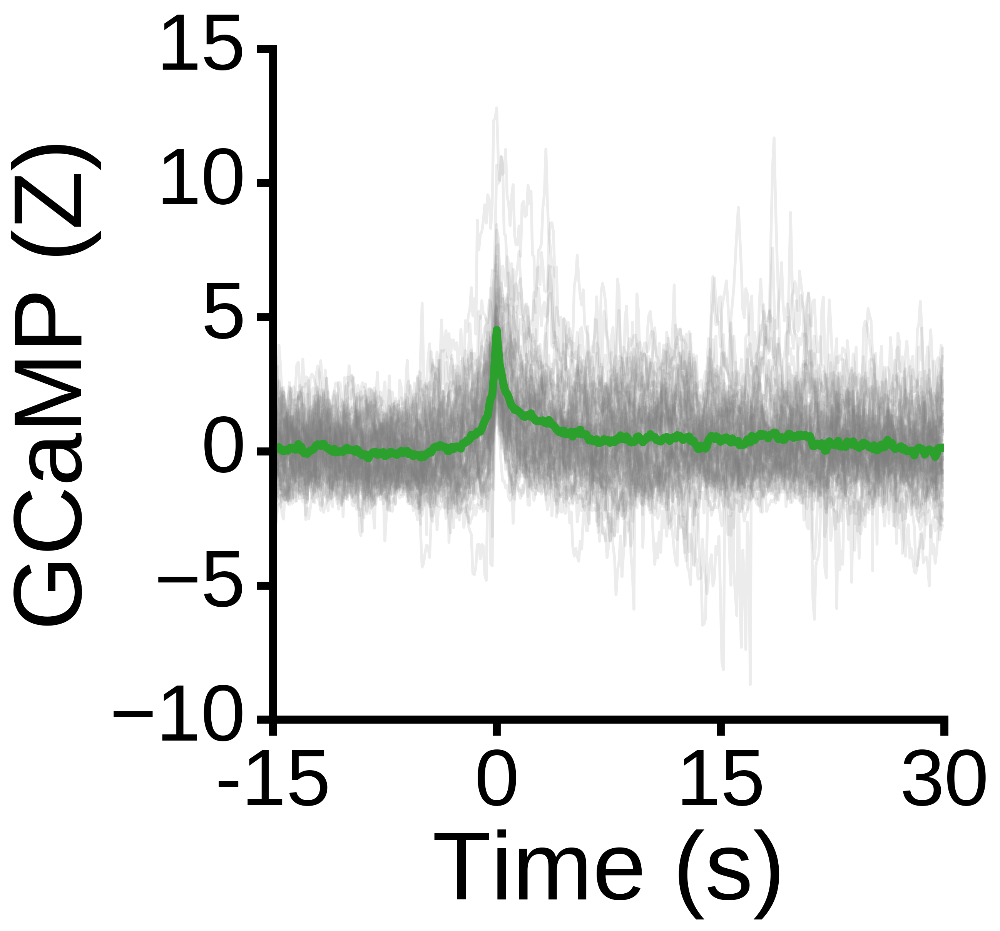

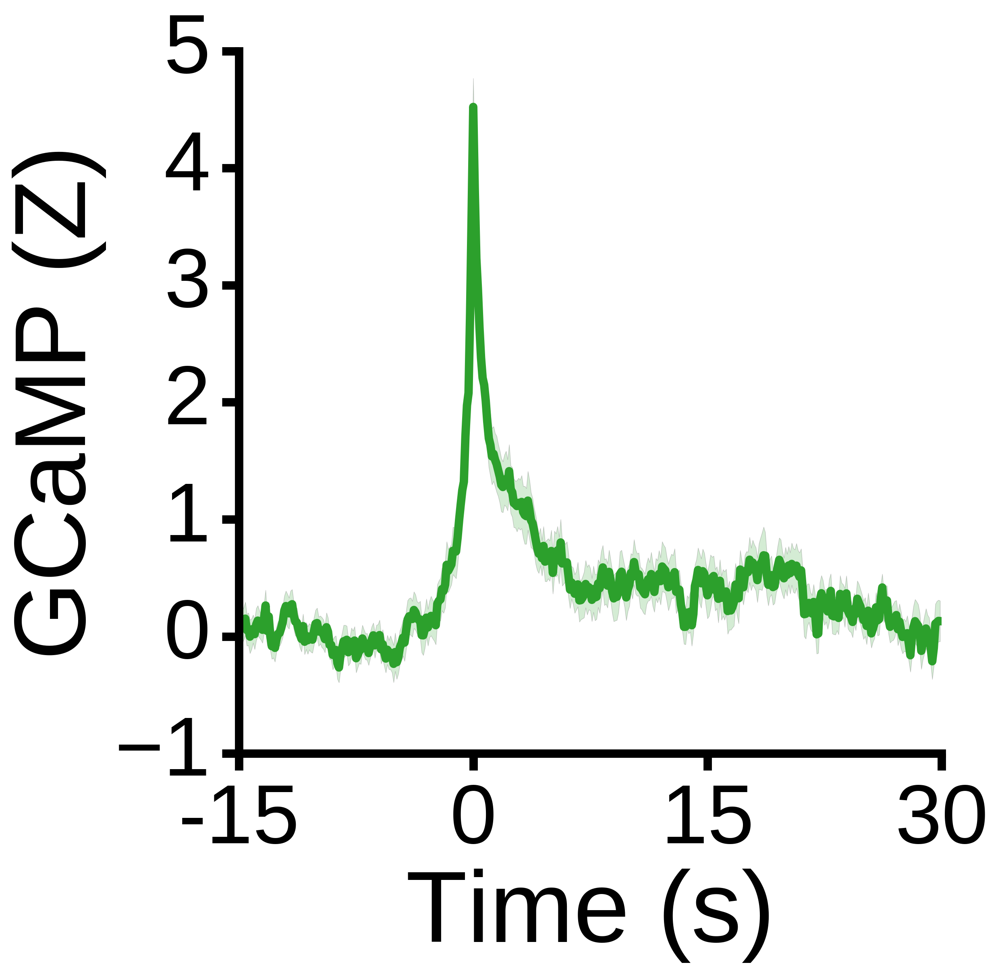

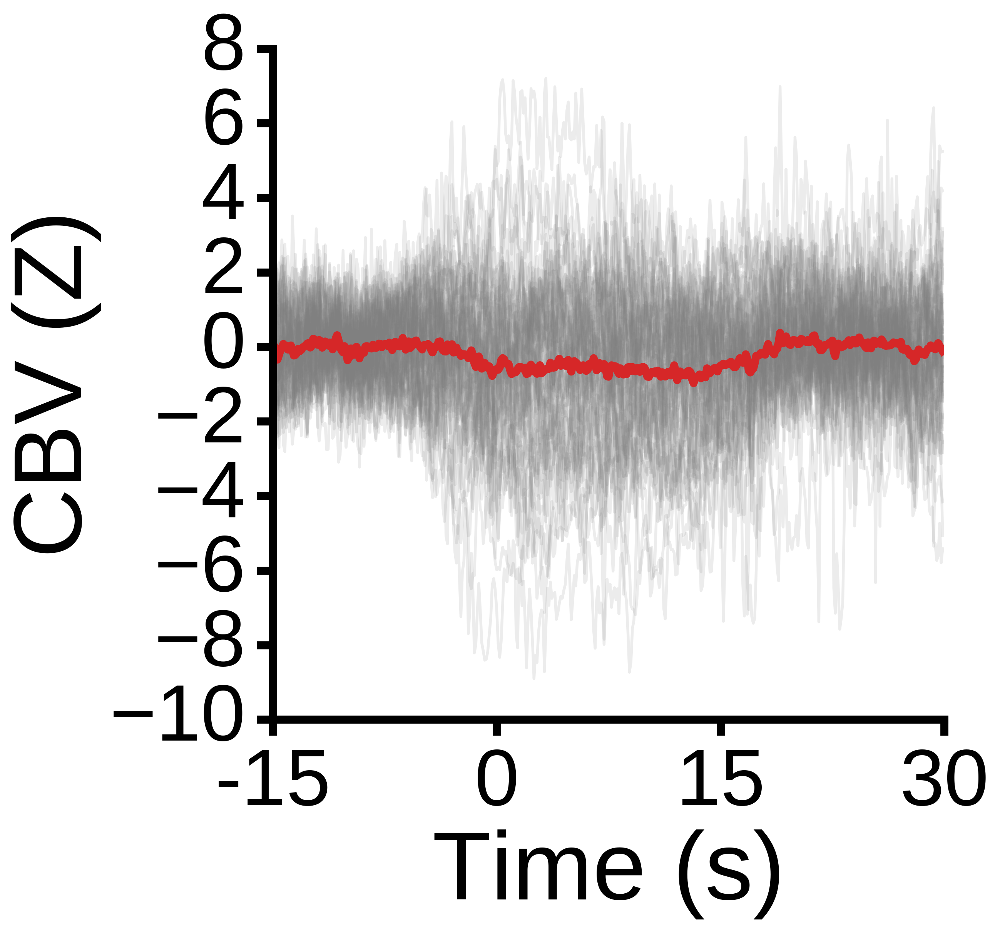

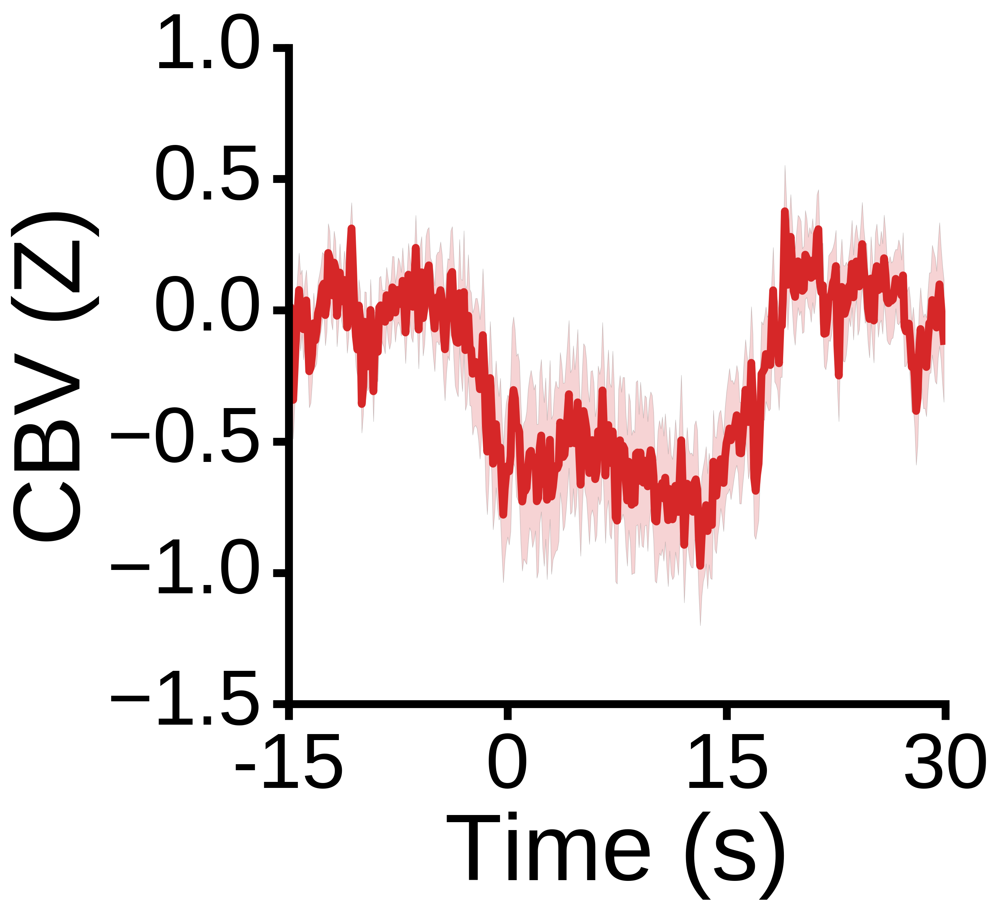

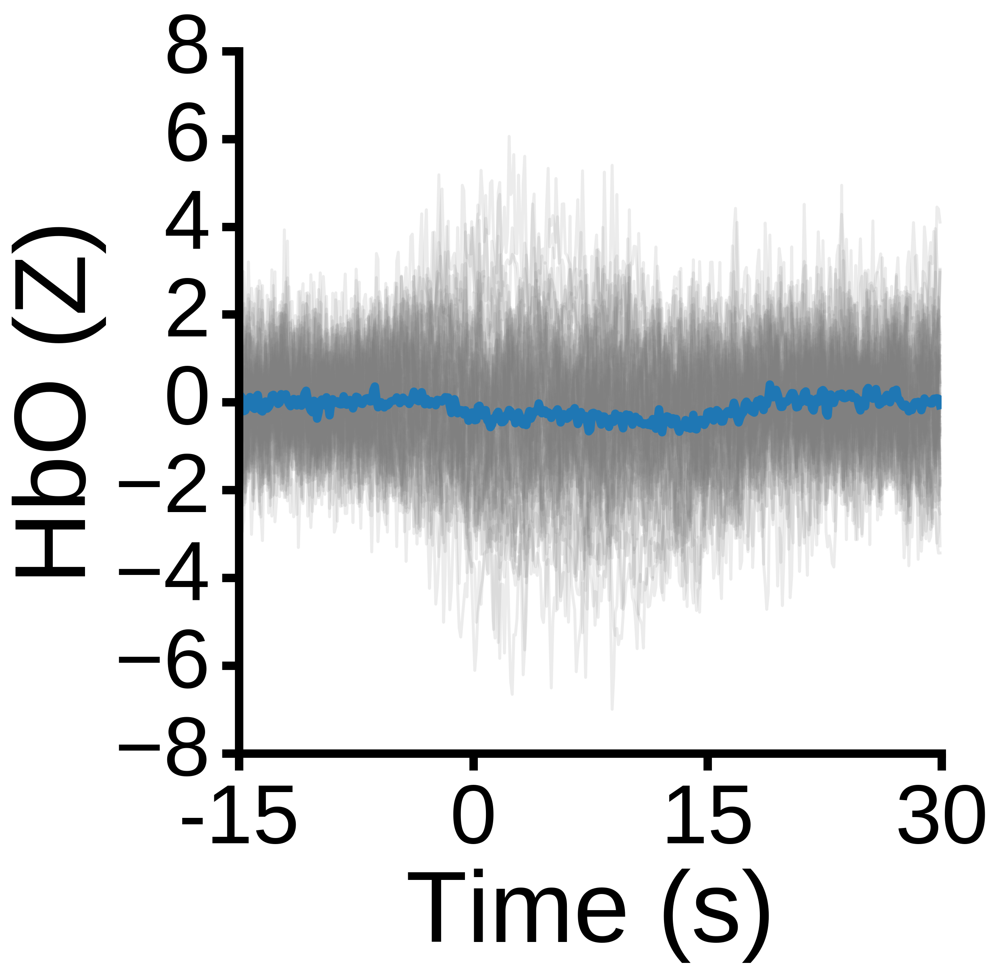

...

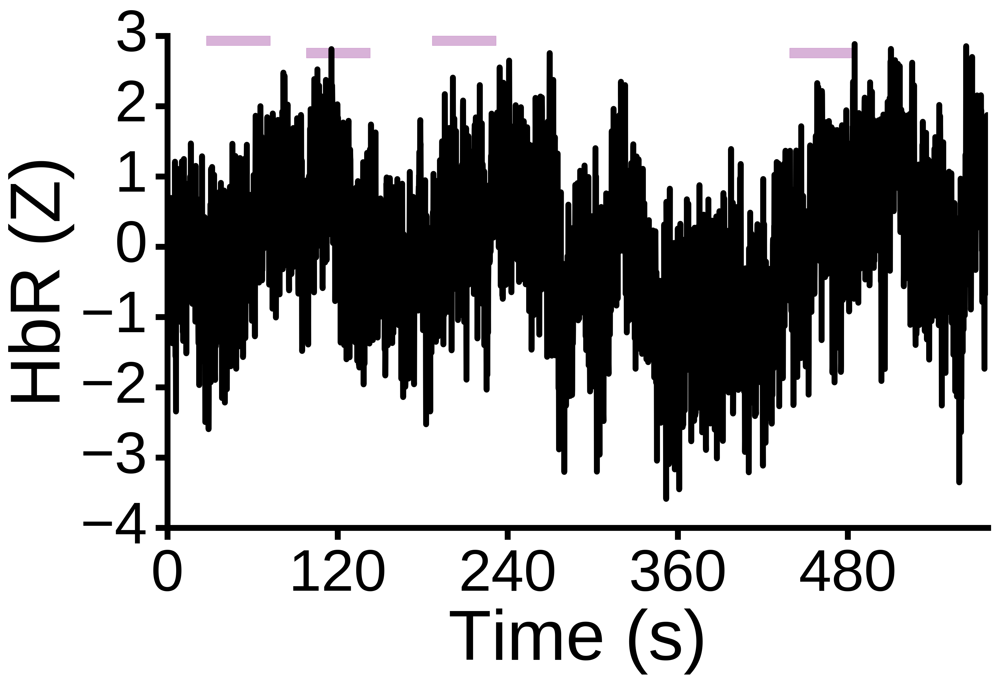

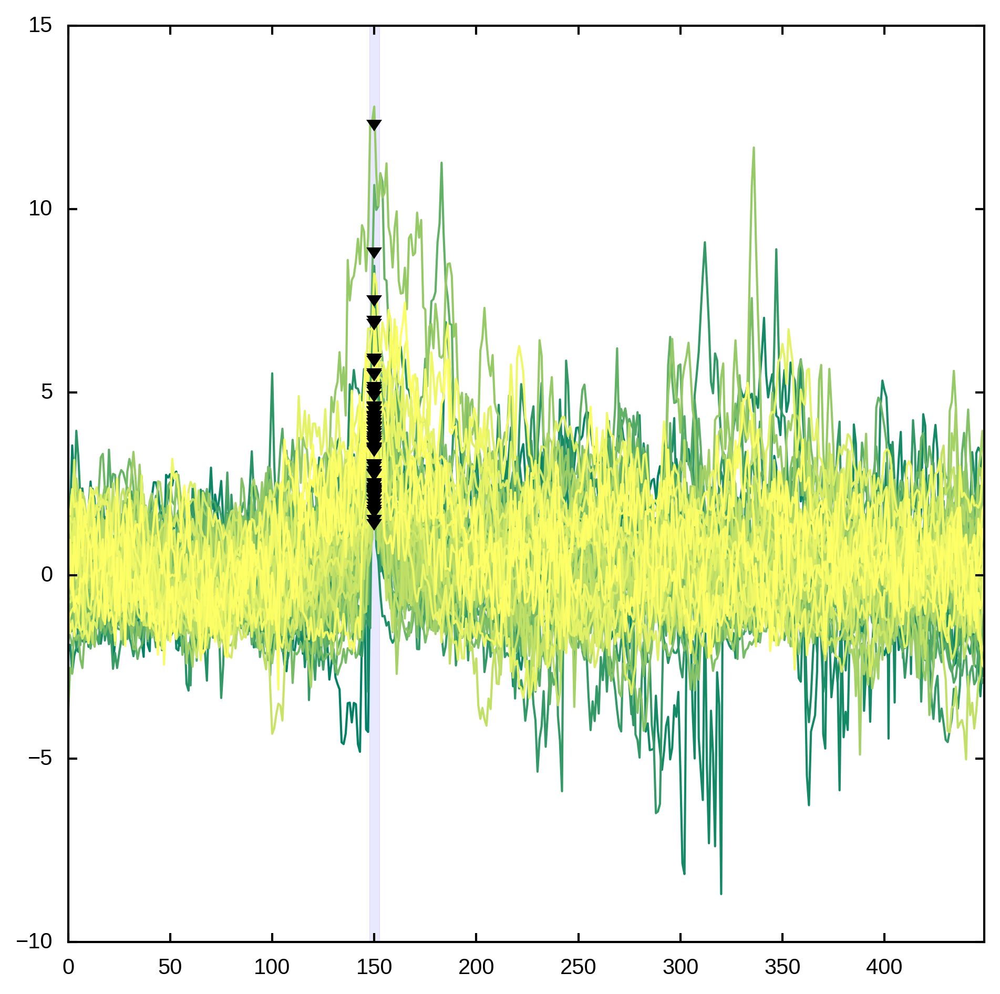

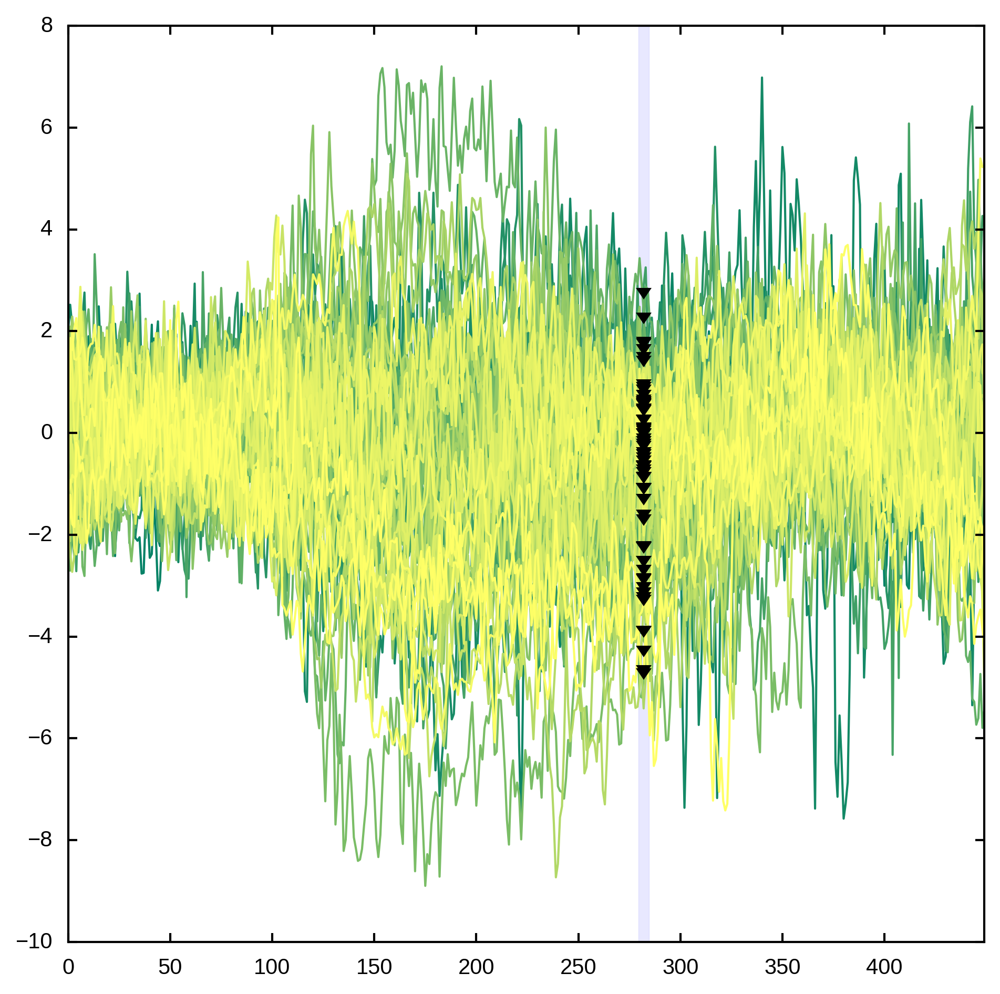

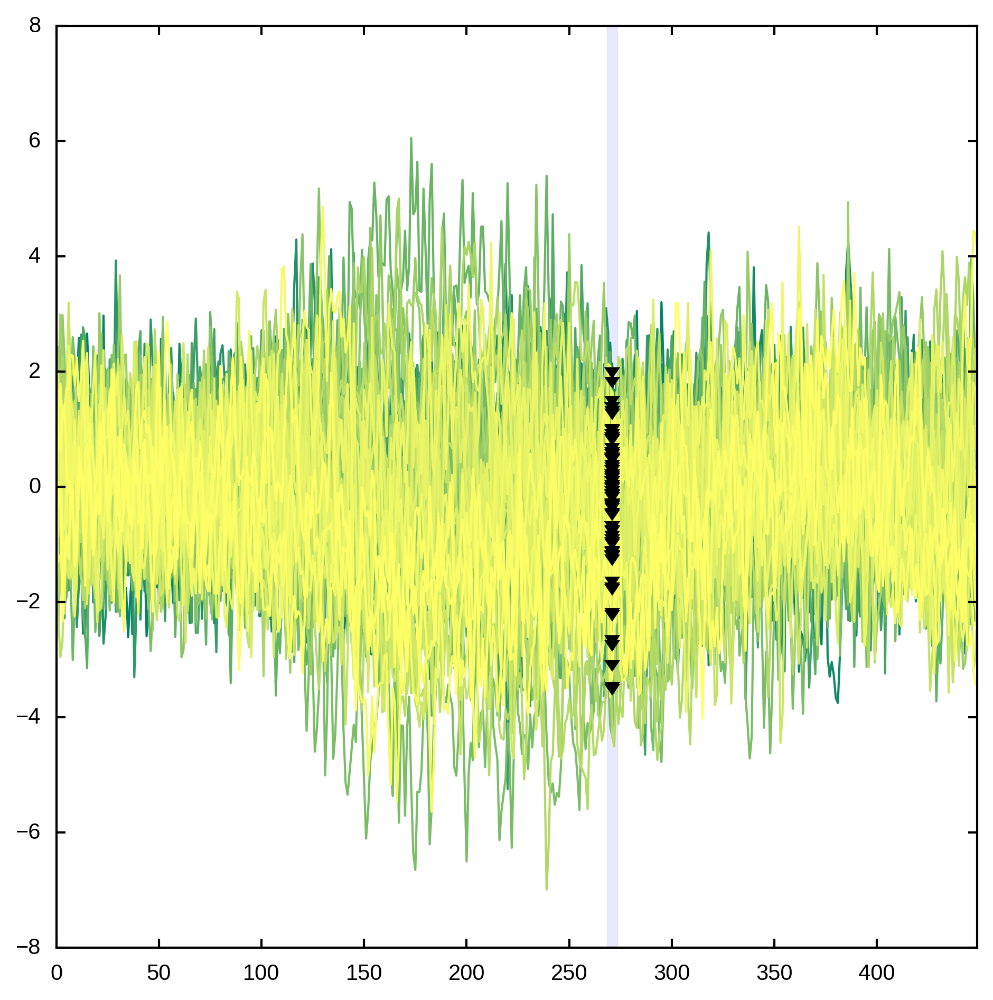

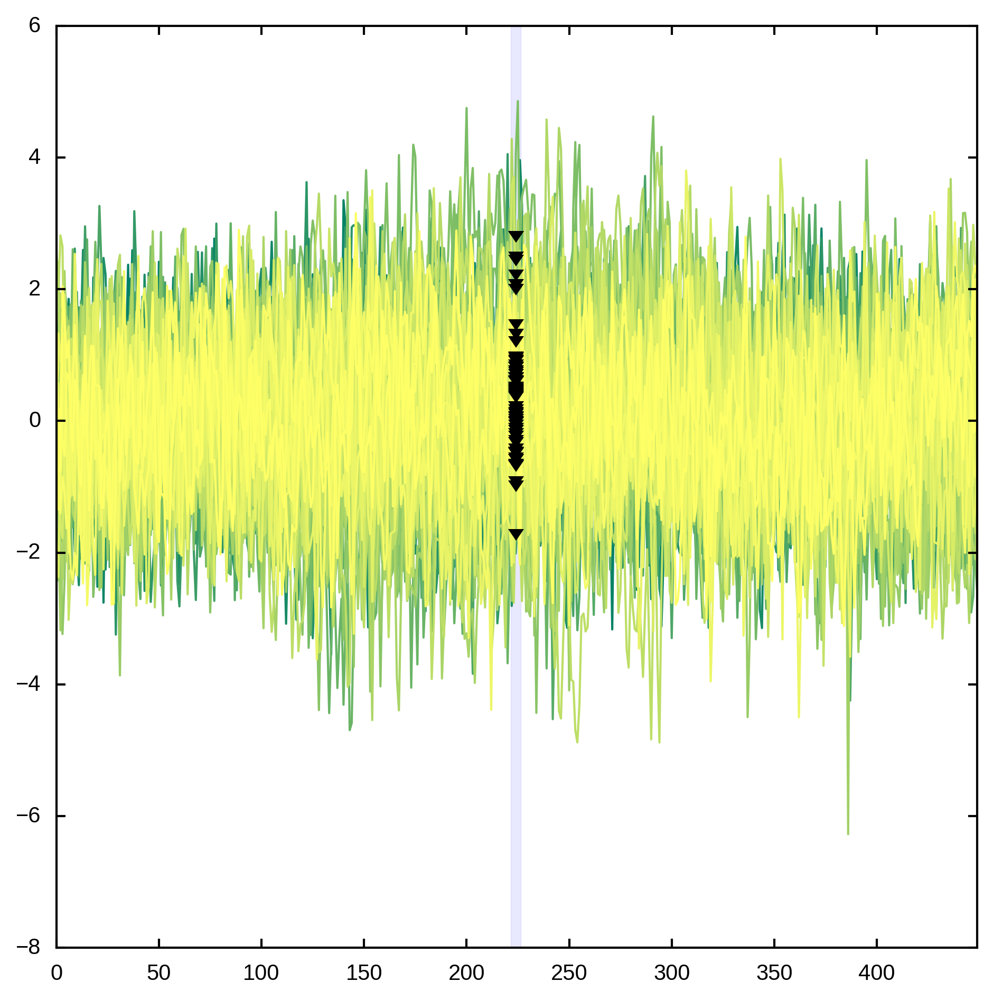

(<matplotlib.figure.Figure at 0x7f2827a8af10>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f28288fb2d0>)

In [14]:
global freq
freq = 10 #adjust to fit sampling rate (Hz) of your data
global cutoff
cutoff = .01 #adjust filter cutoff frequency (hz) as needed
plot_example_data4(prj, 'groupname') #enter name of group folder